# Q2

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os
import copy

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f" Using device: {device}")

 Using device: cuda


In [4]:
# Load the pretrained model
model = models.resnet18(weights=None)

# Modify the last fully connected layer for 10 classes
model.fc = nn.Linear(model.fc.in_features, 10)

state_dict = torch.load("/content/drive/MyDrive/cv_a2/q2/dataset/network_visualization.pth", map_location=torch.device(device), weights_only=True)
model.load_state_dict(state_dict)
model.to(device)
print("Loaded model")

Loaded model


# 2.1

In [5]:
def preprocess(image):
    transform = transforms.Compose([
        transforms.Resize((224, 224)),  # Resize the image
        transforms.ToTensor(),          # Convert the image to a tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), # Normalize
    ])
    return transform(image)

def read_image(image_path):
    img = Image.open(image_path)
    return img

base_folder_path = "/content/drive/MyDrive/cv_a2/q2/dataset/network visualization"
folders = [f.path for f in os.scandir(base_folder_path) if f.is_dir()]

img_idx_to_pick = 3

image_map = {}
label_map = {}
images = []

for i, folder in enumerate(folders):
    filename = os.listdir(folder)[img_idx_to_pick]
    img = read_image(folder + "/" + filename)
    image_map[filename.split(".")[0].split("_")[0]] = img

# Given in question that labels are assigned in alphabetical order in the given trained model weights
alphabetical_order_lables = sorted((image_map.keys()))
for idx, key in enumerate(alphabetical_order_lables):
    images.append(image_map[key])
    label_map[idx] = key

In [6]:
def predict(model, images):
    model.eval()

    predictions = []
    with torch.no_grad():
        for image in images:
            image = preprocess(image).unsqueeze(0).to(device)  # Add batch dimension
            outputs = model(image)
            _, predicted = torch.max(outputs, 1)
            predictions.append(predicted.item())
    return predictions

In [7]:
def plot_predictions(predictions, images, label_map, suptitle):
    fig, axes = plt.subplots(2, len(images) // 2, figsize=(15, 8))
    score = 0
    idx = 0
    for i in range(2):
        for j in range(len(images) // 2):
            img = images[idx]

            if label_map[idx] == label_map[predictions[idx]]:
                score += 1

            axes[i, j].imshow(img.resize((224, 224))) # Reshaped it before visualization for better visualization
            axes[i, j].set_title(f"TL: {label_map[idx]}\nPL: {label_map[predictions[idx]]}")
            axes[i, j].axis('off')
            idx += 1
    plt.suptitle(suptitle + f", Score: [{score}/10]")
    plt.tight_layout()
    plt.show()

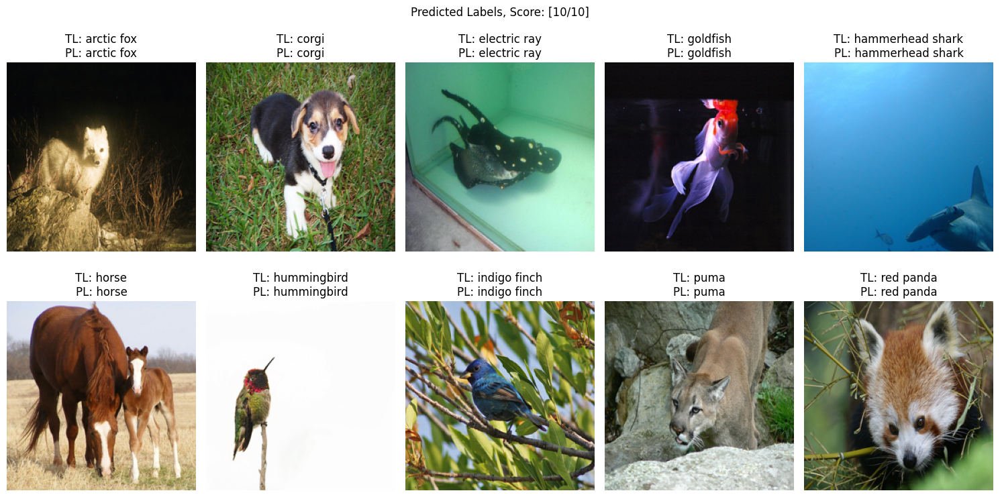

In [8]:
predictions = predict(model, images)
plot_predictions(predictions, images, label_map, "Predicted Labels")

In [9]:
def compute_saliency_map(model, img, true_label):
    model.eval()
    img = preprocess(img).unsqueeze(0).to(device) # Add batch dimension
    img.requires_grad = True
    output = model(img)
    # Output is of shape [1, 10] and we need to get the logit for the true label
    loss = output[0, true_label] # Picking the logit value for the given true label
    loss.backward()              # Backpropagating the loss = value of logit for true label

    # Extracting the final gradient value that reached the image after backprop
    saliency_map = img.grad.data
    # Taking absolute value of the gradients, maxed over rgb channels
    saliency_map = saliency_map.abs().max(dim=1)[0]
    saliency_map = saliency_map.squeeze().cpu().numpy()
    return saliency_map

saliency_maps = []
for idx, img in enumerate(images):
    saliency_map = compute_saliency_map(model, img, idx)
    saliency_maps.append(saliency_map)

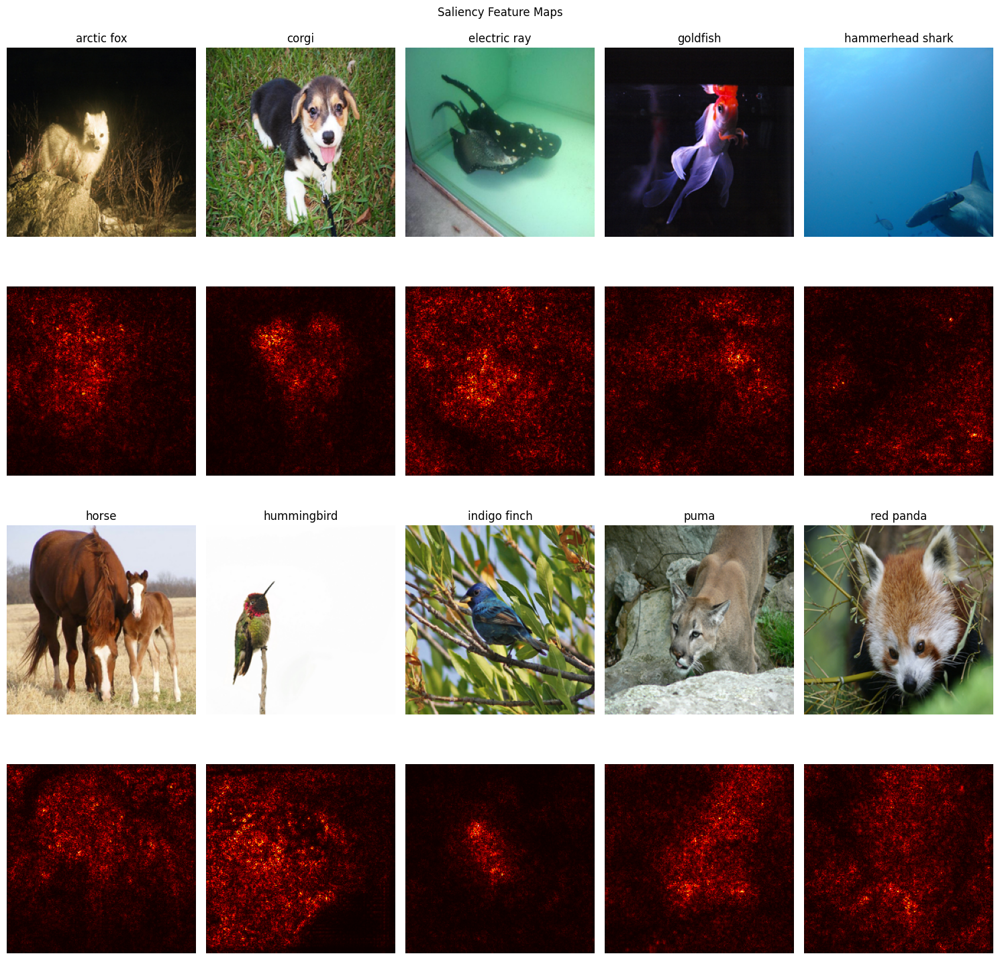

In [10]:
fig, axes = plt.subplots(4, len(folders) // 2, figsize=(15, 15))

idx = 0
for i in range(0, 3, 2):
    for j in range(len(folders) // 2):
        axes[i][j].set_title(label_map[idx])
        axes[i][j].imshow(images[idx].resize((224, 224))) # Reshaped images before visualization for better visualization
        axes[i][j].axis("off")

        axes[i+1][j].imshow(saliency_maps[idx], cmap="hot")
        axes[i+1][j].axis("off")

        idx += 1

plt.suptitle("Saliency Feature Maps")
plt.tight_layout()
plt.show()

In [11]:
combined_saliency_maps = np.stack(saliency_maps, axis=0)
combined_images = np.stack([img.resize((224, 224)) for img in images])

max_val = np.max(combined_saliency_maps)

# Set threshold (T = k *)
k = 0.005
threshold = k * max_val

# Creating binary mask to apply filters
mask = combined_saliency_maps < threshold
mask = np.stack([mask] * 3, axis = -1) # Stacking to match the dimension of image

# Replace with 0
mask_const = np.zeros_like(combined_saliency_maps)
mask_const = np.stack([mask_const] * 3, axis = -1) # Stacking 3 layers to match the dim of image
const_masked_images = np.where(mask, mask_const, combined_images)

gaussian_mean = 128
gaussian_sd = 50

# Replace with Gaussian Noise (Sampled from N(128, 50))
gaussian_noise = np.random.normal(loc=gaussian_mean, scale=gaussian_sd, size=combined_saliency_maps.shape)
gaussian_noise = np.stack([gaussian_noise] * 3, axis = -1)
gaussian_masked_images = np.where(mask, gaussian_noise, combined_images)

# Changing the datatype as Image expects integer instead of float
const_masked_images = (const_masked_images).astype(np.uint8)
gaussian_masked_images = (gaussian_masked_images).astype(np.uint8)

# Unstacking back to individual images (also converting the images to PIL format from np array)
const_masked_images = [Image.fromarray(const_masked_images[i]) for i in range(const_masked_images.shape[0])]
gaussian_masked_images = [Image.fromarray(gaussian_masked_images[i]) for i in range(gaussian_masked_images.shape[0])]

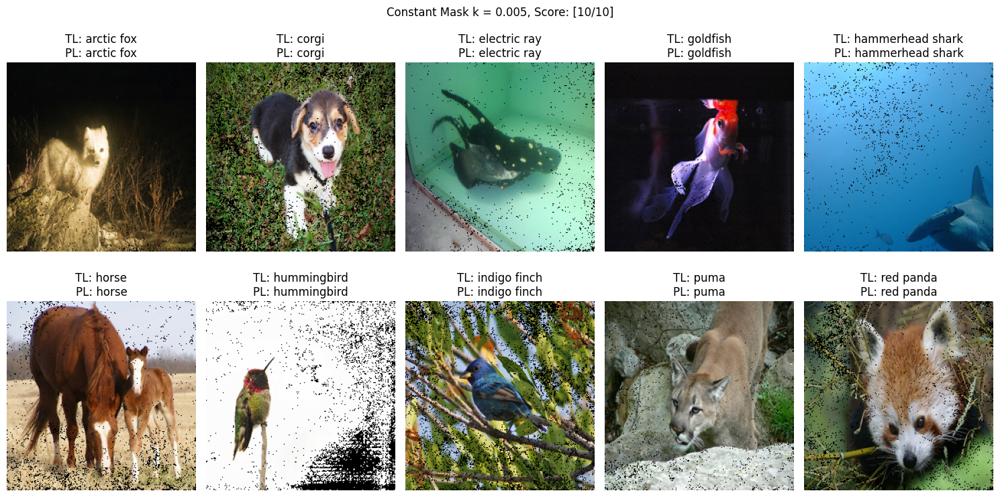

In [12]:
const_masked_predictions = predict(model, const_masked_images)
plot_predictions(const_masked_predictions, const_masked_images, label_map, f"Constant Mask k = {k}")

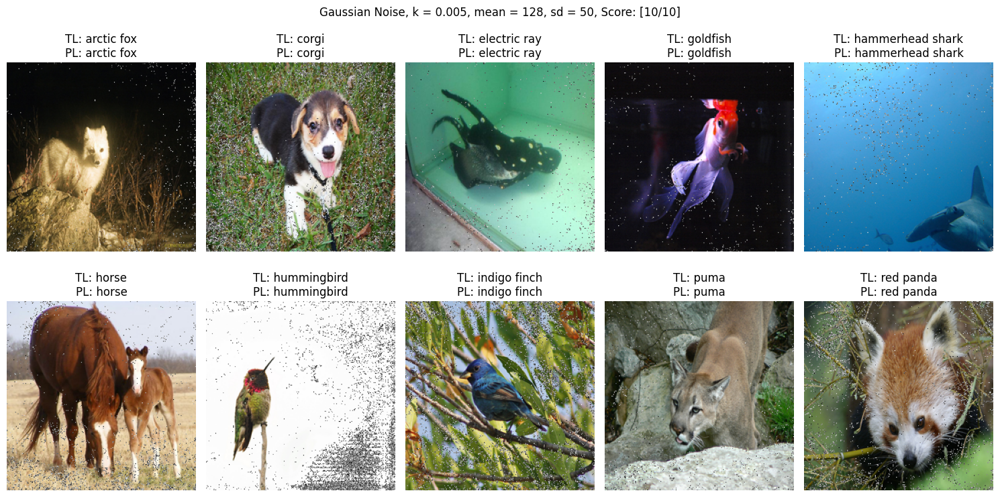

In [13]:
gaussian_masked_predictions = predict(model, gaussian_masked_images)
plot_predictions(gaussian_masked_predictions, gaussian_masked_images, label_map, f"Gaussian Noise, k = {k}, mean = {gaussian_mean}, sd = {gaussian_sd}")

#### Analysis

For the given images, two types of masks were applied:
1. **Constant Mask**: Pixels that do not change significantly during the backward pass are replaced with a constant value (0, 0, 0).
2. **Gaussian Noise Mask**: Pixels that do not change significantly during the backward pass are replaced with Gaussian noise with mean = 128 and standard deviation = 50.

Note: The threshold for classifying the pixels as not significantly changed was determined by `max_val * k` where max_val is the maximum gradient value in saliency map and k determines the partition of max value for threshold.

> Applying constant and Gaussian noise masks to insignificant pixels in images led to a decline in classification accuracy. The Gaussian noise mask performed better than the constant mask since the noise was sampled with mean = 128 and std = 50, making it closer to the original pixel values whereas in constant masked we replaced all the values with 0 in making a significant deviation from the original pixel values (if not dark already).

# 2.2

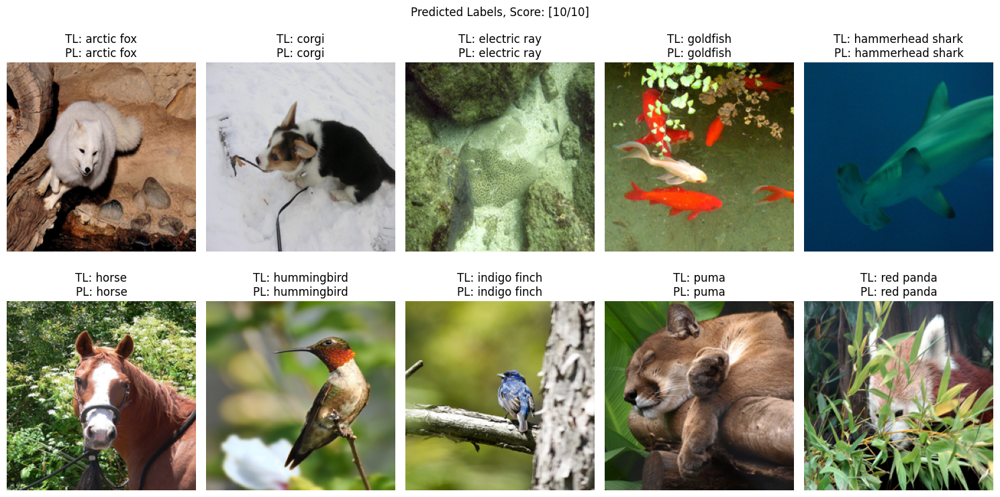

In [14]:
image_map2 = {}
label_map2 = {}

# Picking another set of images
img_idx_to_pick2 = 4

images2 = []

for i, folder in enumerate(folders):
    filename = os.listdir(folder)[img_idx_to_pick2]
    img = read_image(folder + "/" + filename)
    image_map2[filename.split(".")[0].split("_")[0]] = img

# Given in question that labels are assigned in alphabetical order in the given trained model weights
alphabetical_order_lables2 = sorted((image_map2.keys()))
for idx, key in enumerate(alphabetical_order_lables2):
    images2.append(image_map2[key])
    label_map2[idx] = key

predictions = predict(model, images2)
plot_predictions(predictions, images2, label_map2, "Predicted Labels")

In [15]:
def add_gaussian_noise(image, mean=0, std=25):
    noise = np.random.normal(loc=mean, scale=std, size=np.array(image).shape)
    image = np.array(image, dtype=np.float32)
    noisy_image = image + noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    noisy_pil_image = Image.fromarray(noisy_image)
    return noisy_pil_image

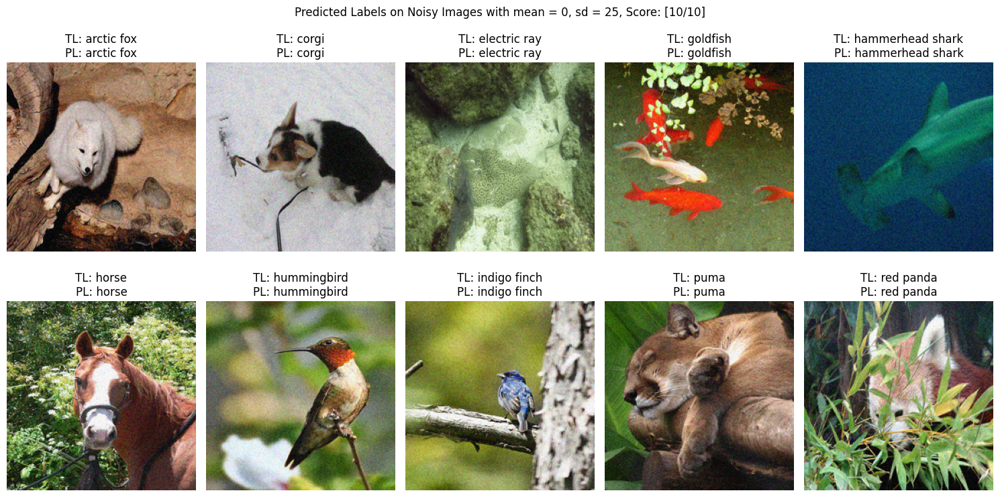

In [16]:
mean = 0
sd = 25
noisy_images = [add_gaussian_noise(image, mean, sd) for image in images2]

predictions = predict(model, noisy_images)
plot_predictions(predictions, noisy_images, label_map, f"Predicted Labels on Noisy Images with mean = {mean}, sd = {sd}")

> Yes the images still visually appear pretty much the same.

In [17]:
def denormalize(img):
    # Undo normalization to get back the original image.
    img = img.clone().detach().cpu().numpy().transpose(1, 2, 0) # The three channels should be at the end
    img = (img * np.array([0.229, 0.224, 0.225])) + np.array([0.485, 0.456, 0.406])
    img = np.clip(img, 0, 1)
    return img

def optimize_image(model, original_img, target_class, n_epochs=10, lr=0.01):
    model.eval()
    original_img = preprocess(original_img).unsqueeze(0).to(device)
    optimised_image = original_img
    optimised_image.requires_grad = True

    # Instead of using torch.no_grad() (which prevents gradient saving for all the parameters)
    # We indivially set required_grad = False for the model weights as we don't want gradients for them
    # We just want to update the values in the input image (optimised image)
    for param in model.parameters():
        param.requires_grad = False
    optimizer = torch.optim.Adam([optimised_image], lr=lr) # Optim takes in the parameters whose value it has to update/optimize

    loss_arr = []
    for i in range(n_epochs):
        optimizer.zero_grad()
        output = model(optimised_image)
        loss = -output[0, target_class] # Minimising neg logit is same as miximising logit
        loss.backward()
        optimizer.step()
        loss_arr.append(loss.item())

        # Limiting the range of values similar to original original_img with the aim that the optimised original_img looks similar
        # to original original_img but is optimised for some other class
        optimised_image.data = optimised_image.data.clamp(original_img.min().item(), original_img.max().item())

    optimised_image = denormalize(optimised_image.squeeze(0))

    return optimised_image, loss_arr

In [28]:
def plot_optimized_and_difference_images(images, label_map, mode, magnification, n_epochs):
    for i, image in enumerate(images):
        # Getting output logits
        with torch.no_grad():
            output = model(preprocess(copy.deepcopy(image)).unsqueeze(0).to(device))
            output = output.cpu().numpy()
            sorted_output = np.argsort(output, axis=1)

        if mode == "second_max":
            target = sorted_output[0][-2]
        elif mode == "lowest":
            target = sorted_output[0][0]

        optimized_img, loss_arr = optimize_image(model, image, target, n_epochs)
        optimized_img = Image.fromarray((optimized_img * 255).astype(np.uint8))

        np_arr_img = np.array(image.resize((224, 224))) # Resizing and coverting to numpy array
        diff_img = np_arr_img.astype(np.float32) - np.array(optimized_img).astype(np.float32)
        diff_img = np.clip(diff_img, 0, 255).astype(np.uint8)
        diff_img2 = 255 - diff_img

        magnified_diff_img = (diff_img * magnification).astype(np.uint8)

        fig, axes = plt.subplots(1, 5, figsize=(15, 4))

        axes[0].imshow(image.resize((224, 224)))
        predictions = predict(model, [image])
        axes[0].set_title(f"Org: {label_map[i]}\nPred: {label_map[predictions[0]]}")
        axes[0].axis("off")

        axes[1].plot(loss_arr)
        axes[1].set_ylabel("Loss")
        axes[1].set_xlabel("Iteration")
        axes[1].set_title("Loss Curve")
        axes[1].set_box_aspect(1)

        axes[2].imshow(optimized_img)
        predictions = predict(model, [optimized_img])
        axes[2].set_title(f"Opt: {label_map[target]}\nPred: {label_map[predictions[0]]}")
        axes[2].axis("off")

        axes[3].imshow(diff_img2)
        axes[3].set_title(f"Diff (inv)")
        axes[3].axis("off")

        axes[4].imshow(magnified_diff_img)
        axes[4].set_title(f"Magnified diff: {magnification}x")
        axes[4].axis("off")

        plt.suptitle(f"{mode}")
        plt.tight_layout()
        plt.show()
        print()

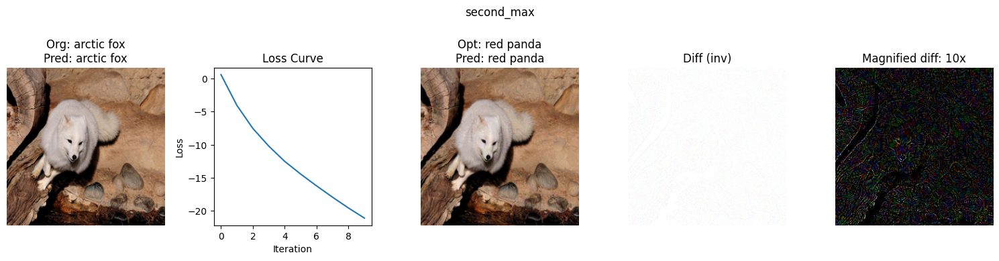

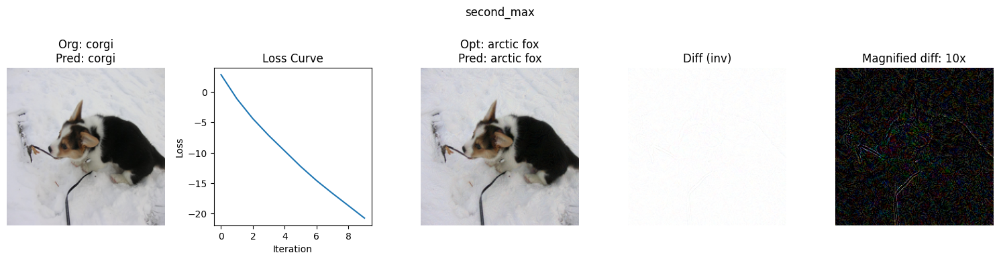

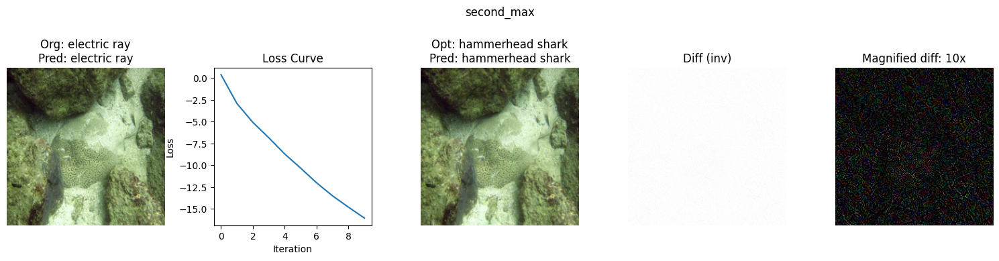

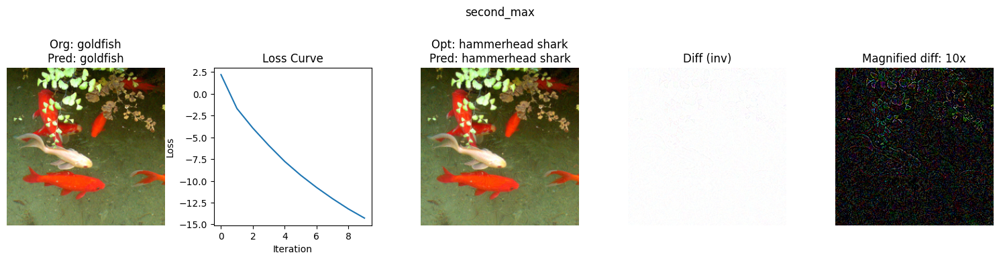

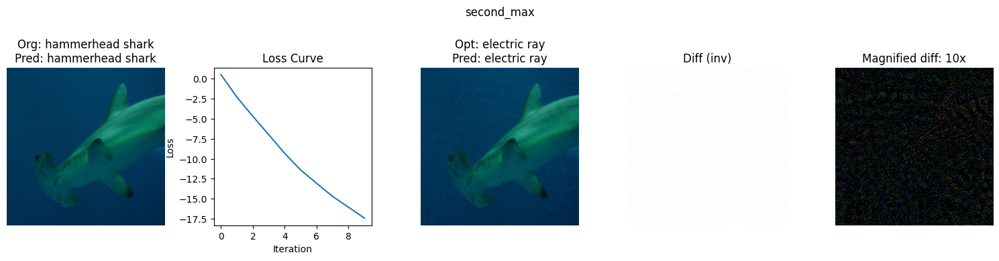

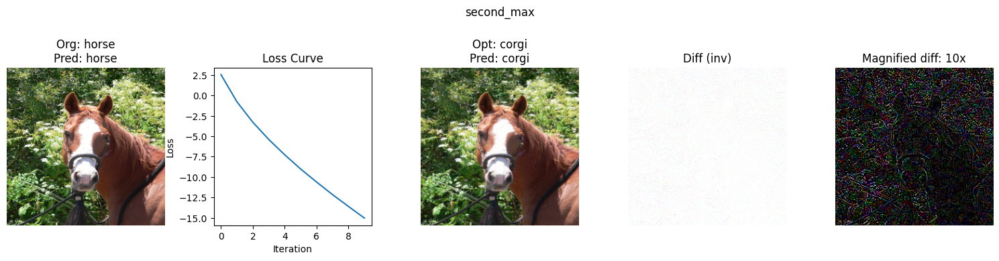

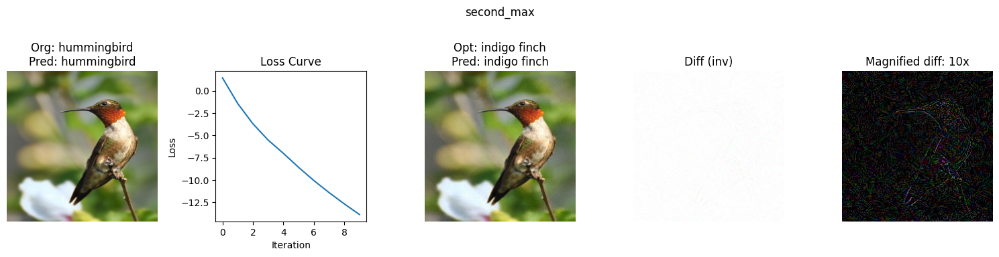

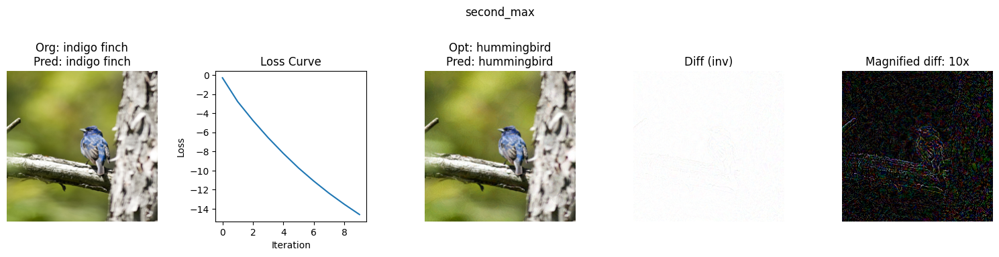

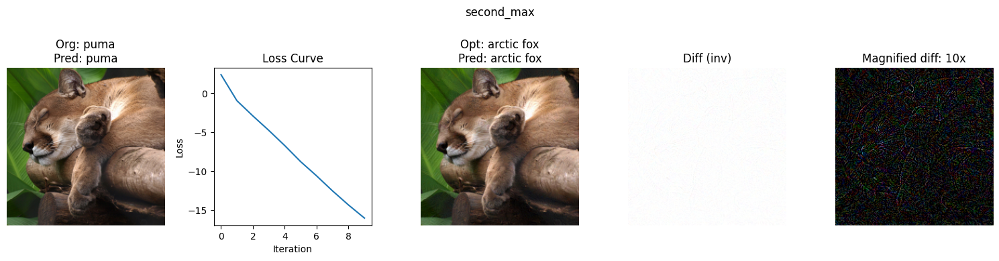

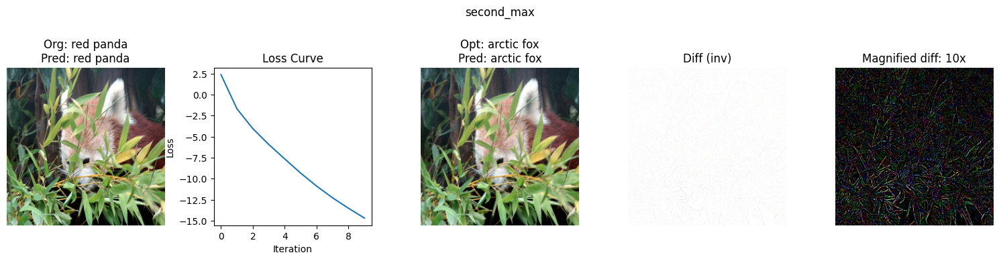

In [31]:
plot_optimized_and_difference_images(images2, label_map2, "second_max", 10, 10)

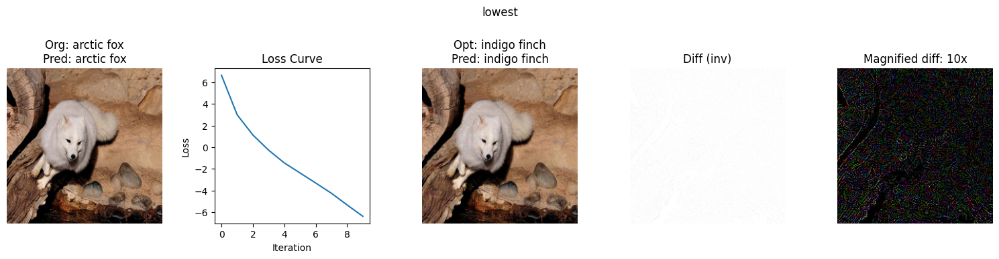

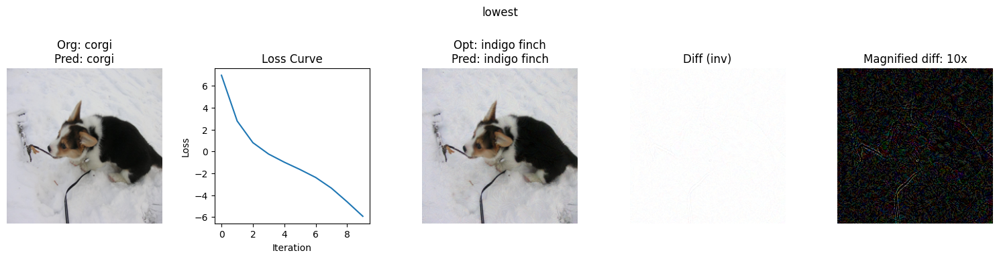

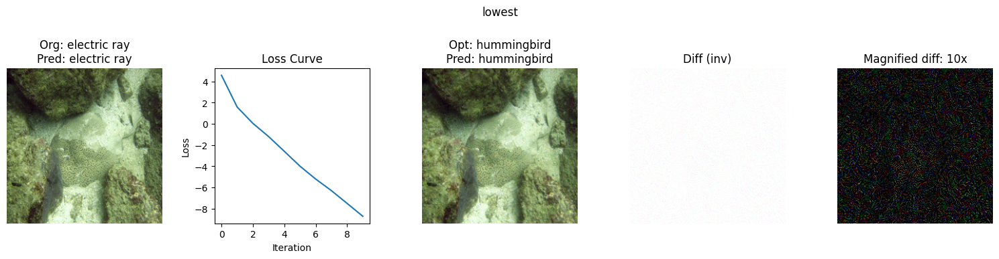

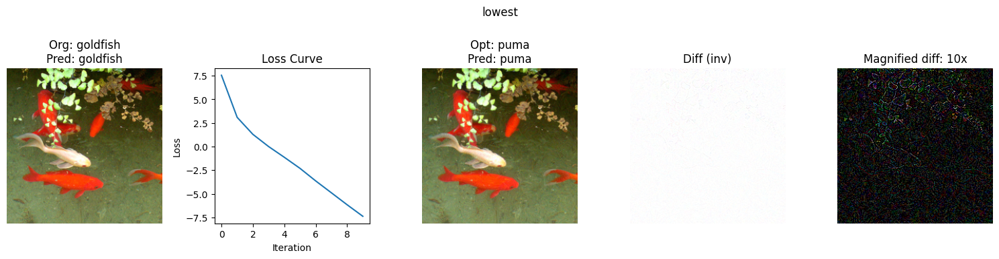

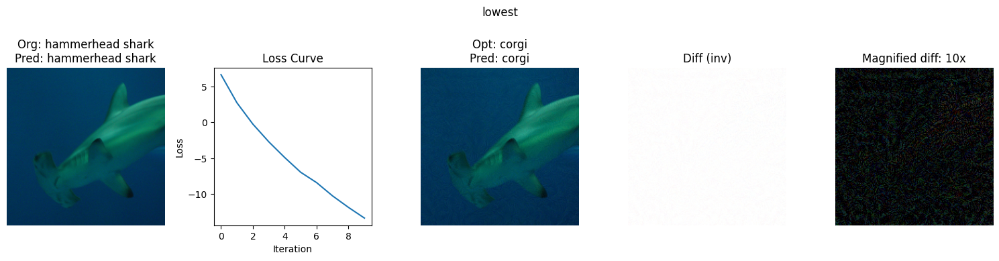

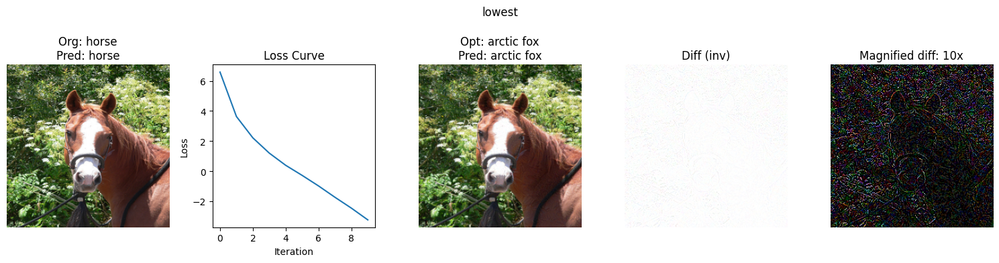

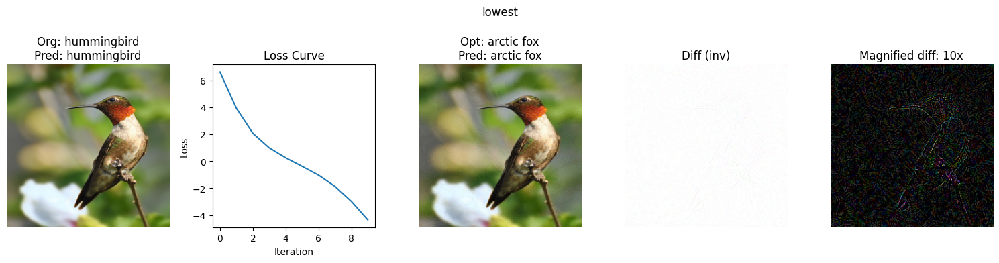

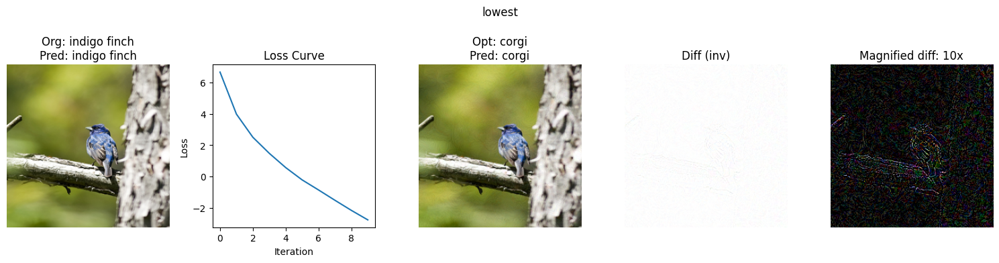

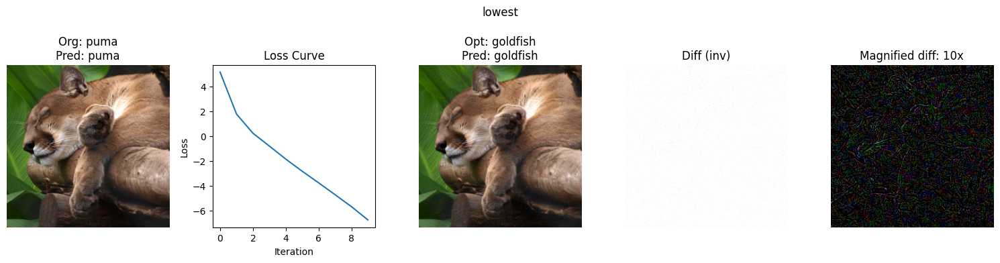

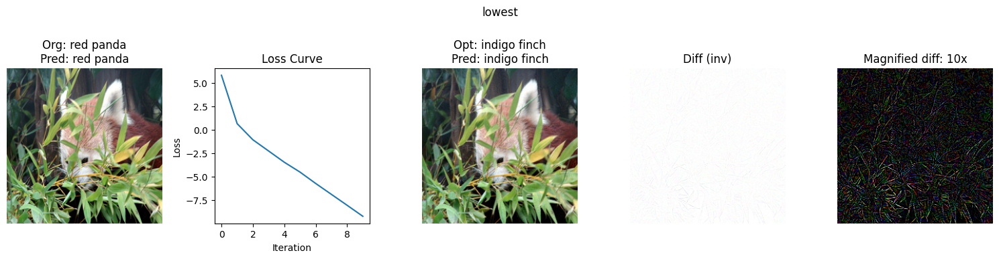

In [32]:
plot_optimized_and_difference_images(images2, label_map2, "lowest", 10, 10)

## Analysis

> Even when optimized images appear nearly identical to the originals, they can still fool the model into predicting the wrong class, revealing its susceptibility to adversarial attacks. Even images shifted toward the lowest probability class look visually similar yet are misclassified. The differences are so subtle they're almost imperceptible—often appearing nearly black when directly compared. A magnified difference image, however, clearly highlights these minute changes that adjust (tried to forget) the key features from the original class to those of the target class according to the model's learned weights (not necessarily to look like the target, it can be random which gives appropriate values for that target logit to be high in output given the frozen model weights).